# VLM Usage - CLIP
- (Image, Text) Contrastive Learning Joint embedding

CLIP (Contrastive Language-Image Pre-training) is a neural network model developed by OpenAI that embeds text and images into a shared vector space, allowing for cross-modal search, zero-shot image classification, and other multimodal applications.

Here's a simplified overview of how CLIP works:

![image.png](https://i.ibb.co/6bw0cf5/workshop3-3-clip.png)

**Text Embedding**:
- Text input (e.g., a sentence or phrase) is tokenized into subwords (smaller units of text).
- The tokenized text is fed into a transformer encoder (a type of neural network architecture).
- The transformer encoder generates a text embedding, a numerical representation of the text.

**Image Embedding**:
- Image input (e.g., a picture) is resized and normalized.
- The image is fed into ViT (Vision Tranformer), thus generates an image embedding, a numerical representation of the image.

**Shared Vector Space**:
- CLIP uses a contrastive learning approach to align the text and image embeddings in a shared vector space.
- The model is trained on a large dataset of image-text pairs, such as images with captions.
- The goal is to maximize the similarity between the text and image embeddings for matching pairs, while minimizing the similarity for non-matching pairs.


![image.png](https://i.ibb.co/FJwypVs/workshop-3-clip-embed.png)
*Adapted from https://www.pinecone.io/learn/series/image-search/zero-shot-object-detection-clip/ *

**Usage**:
- Once trained, CLIP embed text and images into the shared vector space.
- This allows
    - Zero-shot image classification
    - Cross-modal search

# Via pretrained model

In [1]:
from PIL import Image
import torch
import requests
from transformers import CLIPProcessor, CLIPModel
from matplotlib import pyplot as plt
import torch

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

/Users/e-rongyong/brainhack-til/til-24-curriculum/venv/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


We initialize the model from HuggingFace. Note that the `processor` includes both the tokenizer and the image processor, which would normally be separate.

In [2]:
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")
# there is a larger/more comprehensive model - openai/clip-vit-large-patch14, that should have better performance, but also require more compute
model.to(device)
print("load!")

/Users/e-rongyong/brainhack-til/til-24-curriculum/venv/lib/python3.12/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


load!


To demonstrate the model, we download and display an image of cats from the COCO dataset.

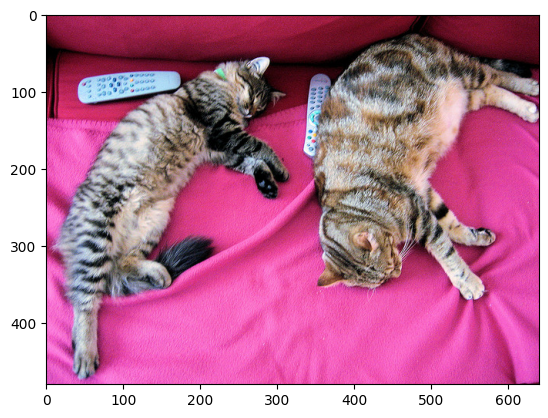

In [3]:
url = "http://images.cocodataset.org/val2017/000000039769.jpg"
image = Image.open(requests.get(url, stream=True).raw)
plt.imshow(image)
plt.show()

Now we can take this image along with some possible captions, pass it through the processor, and get back the label probabilities from CLIP.

In [12]:
inputs = processor(
    text=["ginger cat", "white cat","black cat", "daihdoiwuha78t8b78yoiyu iuhw88hh2bjbdkwh"],
    images=image,
    return_tensors="pt",
    padding=True,
)
inputs.to(device)
with torch.no_grad():
    outputs = model(**inputs)
logits_per_image = outputs.logits_per_image  # this is the image-text similarity score
probs = logits_per_image.softmax(
    dim=1
)  # we can take the softmax to get the label probabilities
for prob, label in zip(probs[0], ("ginger", "white", "black", "random")):
    print(f"{label}: {prob: .3f}")

ginger:  0.328
white:  0.028
black:  0.046
random:  0.598


The code above loads the CLIP model and processor, downloads an image of a cat, and runs the image through the model with two different text prompts: "a photo of a cat" and "a photo of a dog". The model outputs a similarity score for each prompt, which is then converted to a probability using softmax. The probabilities are printed out for each label. 

In this case, the model correctly identifies the image as a cat with a higher probability compared to a dog.

# Exercise (10 mins)

**1. Experiment with modifying the query text & label in the last cell**  
Observe how the confidence score changes when you vary different things.
- Objects that are in the scene? Objects that aren't?
- What about details which are/aren't in the scene?
- Specific types of objects? Parts of objects?
- What if you query with random text/vague description?



**2. Classifying Non-Common Objects**

Load images from the imgs directory and query it with text, does CLIP work?

Weblinks for images
- hot air balloon : https://i.ibb.co/RBgthgt/hot-air-balloon.jpg"
- beach-chair : "https://i.ibb.co/prG3Ctt/beach-chair.jpg"
- horserider : "https://i.ibb.co/r4Zfg15/horserider.jpg"

In [13]:
urls = ["https://i.ibb.co/RBgthgt/hot-air-balloon.jpg", "https://i.ibb.co/prG3Ctt/beach-chair.jpg", "https://i.ibb.co/r4Zfg15/horserider.jpg"]
names = ["hot air balloon", "beach-chair", "horserider"]

image_dict = {name:Image.open(requests.get(url, stream=True).raw) for name, url in zip(names, urls)}

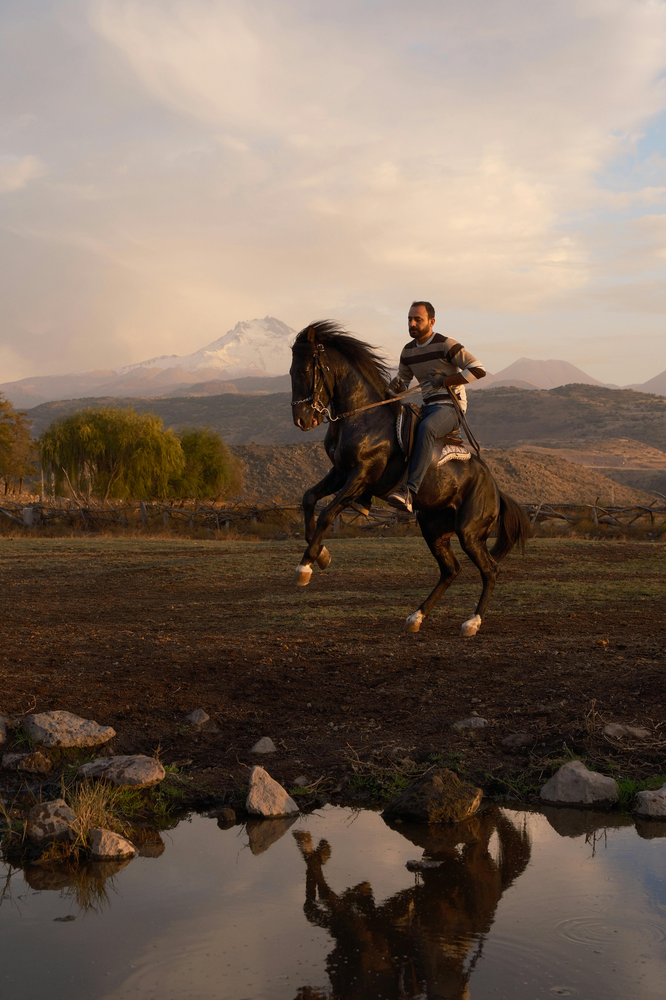

In [23]:
image_dict["horserider"]

In [20]:
def clip_classify(labels:list, image):
    inputs = processor(
    text=labels,
    images=image,
    return_tensors="pt",
    padding=True,
)
    inputs.to(device)
    with torch.no_grad():
        outputs = model(**inputs)
    logits_per_image = outputs.logits_per_image  # this is the image-text similarity score
    probs = logits_per_image.softmax(
        dim=1
    )  # we can take the softmax to get the label probabilities
    for prob, label in zip(probs[0], labels):
        print(f"{label}: {prob: .3f}")
    
    
    

In [17]:
clip_classify(["balloon", "ball"], image_dict["hot air balloon"])

balloon:  0.990
ball:  0.010


In [22]:
clip_classify(["chair", "beach"], image_dict["beach-chair"])

chair:  0.511
beach:  0.489


In [25]:
clip_classify(["horse", "centaur"], image_dict["horserider"])

horse:  0.927
centaur:  0.073


**What to Reflect On:**
- How does the model's performance change when querying for different things?
- How does the model generalize to non-common objects and unseen data?
- What are the limitations and potential biases of the model?

The model's performance is good in general and relatively fast. It struggles with text and images it has not seen much of, using a long random mishmash of strings has the highest score as it is very easy to relate it to the image.

## Resources:
1. [HF CLIP Usage](https://huggingface.co/docs/transformers/en/model_doc/clip#usage-tips-and-example)
2. [OpenAI CLIP](https://openai.com/index/clip/)
3. [Pinecone OD Clip](https://www.pinecone.io/learn/series/image-search/zero-shot-object-detection-clip/)